In [7]:
# Import the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.vector_ar.var_model import VAR

In [8]:
#importing the dataset
WeatherData = pd.read_csv("C:/Users/sumit/Downloads/iNeuron_FSDA-main/EDA Project/Hicounciler Wheather&Forcast/weather_dataset_stage1.csv")
WeatherData.head()

,Date,Temperature,Average humidity (%,Average dewpoint (��,Average barometer (in,Average windspeed (mph,Average gustspeed (mph,Average direction (����,Rainfall for month (in,Rainfall for year (in,...,Maximum humidity (%,Minimum humidity (%,Maximum pressure,Minimum pressure,Maximum windspeed (mph,Maximum gust speed (mph,Maximum heat index (��,Date1,Month,diff_pressure
0,01/01/2022,'37.8','35.0','12.7','29.7','26.4','36.8','274.0','0.0','0.0',...,'4.0','27.0','29.762','29.596','41.4','59.0','40.0','2022-01-01','01','0.16600000000000037'
1,2022-01-02','43.2','32.0','14.7','29.5','12.8','18.0','240.0','0.0','0.0',...,'4.0','16.0','29.669','29.268','35.7','51.0','52.0','2022-01-02','01','0.4009999999999998'
2,2022-01-03','25.7','60.0','12.7','29.7','8.3','12.2','290.0','0.0','0.0',...,'8.0','35.0','30.232','29.26','25.3','38.0','41.0','2022-01-03','01','0.9719999999999978'
3,2022-01-04','9.3','67.0','0.1','30.4','2.9','4.5','47.0','0.0','0.0',...,'7.0','35.0','30.566','30.227','12.7','20.0','32.0','2022-01-04','01','0.33899999999999864'
4,2022-01-05','23.5','30.0','-5.3','29.9','16.7','23.1','265.0','0.0','0.0',...,'5.0','13.0','30.233','29.568','38.0','53.0','32.0','2022-01-05','01','0.6649999999999991'


In [9]:
WeatherData.tail()

,Date,Temperature,Average humidity (%,Average dewpoint (��,Average barometer (in,Average windspeed (mph,Average gustspeed (mph,Average direction (����,Rainfall for month (in,Rainfall for year (in,...,Maximum humidity (%,Minimum humidity (%,Maximum pressure,Minimum pressure,Maximum windspeed (mph,Maximum gust speed (mph,Maximum heat index (��,Date1,Month,diff_pressure
3898,2022-07-25','62.8','60.0','48.1','29.7','2.5','4.0','242.0','0.33','4.47',...,'90.0','36.0','29.781','29.645','8.1','17.3','77.5','2022-07-25','07','0.13599999999999923'
3899,2022-07-26','60.6','68.0','48.9','29.8','1.7','2.9','357.0','0.33','4.47',...,'90.0','40.0','29.93','29.745','11.5','15.0','77.5','2022-07-26','07','0.18499999999999872'
3900,2022-07-27','61.7','64.0','47.4','29.9','2.2','4.0','66.0','0.33','4.47',...,'96.0','35.0','29.941','29.781','13.8','18.4','78.2','2022-07-27','07','0.16000000000000014'
3901,2022-07-28','60.5','61.0','45.3','29.7','4.0','6.2','248.0','0.35','4.49',...,'94.0','35.0','29.792','29.675','17.3','26.5','77.6','2022-07-28','07','0.11700000000000088';
3902,2022-07-28','60.5','61.0','45.3','29.7','4.0','6.2','248.0','0.35','4.49',...,'94.0','35.0','29.792','29.675','17.3','26.5','77.6','2022-07-28','07','0.11700000000000088';


In [10]:
WeatherData.shape

(3903, 23)

In [11]:
WeatherData.dtypes

Date                        object
 Temperature                object
 Average humidity (%        object
 Average dewpoint (��       object
 Average barometer (in      object
 Average windspeed (mph     object
 Average gustspeed (mph     object
 Average direction (����    object
 Rainfall for month (in     object
Rainfall for year (in       object
 Maximum rain per minute    object
 Maximum temperature (��    object
 Minimum temperature (��    object
 Maximum humidity (%        object
 Minimum humidity (%        object
 Maximum pressure           object
 Minimum pressure           object
 Maximum windspeed (mph     object
 Maximum gust speed (mph    object
 Maximum heat index (��     object
Date1                       object
 Month                      object
 diff_pressure              object
dtype: object

In [12]:
WeatherData.isnull().sum()

Date                        0
 Temperature                0
 Average humidity (%        0
 Average dewpoint (��       0
 Average barometer (in      0
 Average windspeed (mph     0
 Average gustspeed (mph     0
 Average direction (����    0
 Rainfall for month (in     0
Rainfall for year (in       0
 Maximum rain per minute    0
 Maximum temperature (��    0
 Minimum temperature (��    0
 Maximum humidity (%        0
 Minimum humidity (%        0
 Maximum pressure           0
 Minimum pressure           0
 Maximum windspeed (mph     0
 Maximum gust speed (mph    0
 Maximum heat index (��     0
Date1                       0
 Month                      0
 diff_pressure              0
dtype: int64

In [13]:
WeatherData[['Date','Date1']]

,Date,Date1
0,01/01/2022,'2022-01-01'
1,2022-01-02','2022-01-02'
2,2022-01-03','2022-01-03'
3,2022-01-04','2022-01-04'
4,2022-01-05','2022-01-05'
...,...,...
3898,2022-07-25','2022-07-25'
3899,2022-07-26','2022-07-26'
3900,2022-07-27','2022-07-27'
3901,2022-07-28','2022-07-28'


In [14]:
WeatherData = WeatherData.drop(['Date1'],axis = 1)
WeatherData.head()

,Date,Temperature,Average humidity (%,Average dewpoint (��,Average barometer (in,Average windspeed (mph,Average gustspeed (mph,Average direction (����,Rainfall for month (in,Rainfall for year (in,...,Minimum temperature (��,Maximum humidity (%,Minimum humidity (%,Maximum pressure,Minimum pressure,Maximum windspeed (mph,Maximum gust speed (mph,Maximum heat index (��,Month,diff_pressure
0,01/01/2022,'37.8','35.0','12.7','29.7','26.4','36.8','274.0','0.0','0.0',...,'34.0','4.0','27.0','29.762','29.596','41.4','59.0','40.0','01','0.16600000000000037'
1,2022-01-02','43.2','32.0','14.7','29.5','12.8','18.0','240.0','0.0','0.0',...,'37.0','4.0','16.0','29.669','29.268','35.7','51.0','52.0','01','0.4009999999999998'
2,2022-01-03','25.7','60.0','12.7','29.7','8.3','12.2','290.0','0.0','0.0',...,'6.0','8.0','35.0','30.232','29.26','25.3','38.0','41.0','01','0.9719999999999978'
3,2022-01-04','9.3','67.0','0.1','30.4','2.9','4.5','47.0','0.0','0.0',...,'-0.0','7.0','35.0','30.566','30.227','12.7','20.0','32.0','01','0.33899999999999864'
4,2022-01-05','23.5','30.0','-5.3','29.9','16.7','23.1','265.0','0.0','0.0',...,'15.0','5.0','13.0','30.233','29.568','38.0','53.0','32.0','01','0.6649999999999991'


In [15]:
WeatherData.head()

,Date,Temperature,Average humidity (%,Average dewpoint (��,Average barometer (in,Average windspeed (mph,Average gustspeed (mph,Average direction (����,Rainfall for month (in,Rainfall for year (in,...,Minimum temperature (��,Maximum humidity (%,Minimum humidity (%,Maximum pressure,Minimum pressure,Maximum windspeed (mph,Maximum gust speed (mph,Maximum heat index (��,Month,diff_pressure
0,01/01/2022,'37.8','35.0','12.7','29.7','26.4','36.8','274.0','0.0','0.0',...,'34.0','4.0','27.0','29.762','29.596','41.4','59.0','40.0','01','0.16600000000000037'
1,2022-01-02','43.2','32.0','14.7','29.5','12.8','18.0','240.0','0.0','0.0',...,'37.0','4.0','16.0','29.669','29.268','35.7','51.0','52.0','01','0.4009999999999998'
2,2022-01-03','25.7','60.0','12.7','29.7','8.3','12.2','290.0','0.0','0.0',...,'6.0','8.0','35.0','30.232','29.26','25.3','38.0','41.0','01','0.9719999999999978'
3,2022-01-04','9.3','67.0','0.1','30.4','2.9','4.5','47.0','0.0','0.0',...,'-0.0','7.0','35.0','30.566','30.227','12.7','20.0','32.0','01','0.33899999999999864'
4,2022-01-05','23.5','30.0','-5.3','29.9','16.7','23.1','265.0','0.0','0.0',...,'15.0','5.0','13.0','30.233','29.568','38.0','53.0','32.0','01','0.6649999999999991'


In [16]:
for i in range(1,len(WeatherData.columns)):
    for j in range(len(WeatherData.iloc[:,i])):
        WeatherData.iloc[:,i][j]=float(WeatherData.iloc[:,i][j].strip("';"))

In [17]:
#for i in range(1,len(WeatherData.columns)):
WeatherData

,Date,Temperature,Average humidity (%,Average dewpoint (��,Average barometer (in,Average windspeed (mph,Average gustspeed (mph,Average direction (����,Rainfall for month (in,Rainfall for year (in,...,Minimum temperature (��,Maximum humidity (%,Minimum humidity (%,Maximum pressure,Minimum pressure,Maximum windspeed (mph,Maximum gust speed (mph,Maximum heat index (��,Month,diff_pressure
0,01/01/2022,37.8,35.0,12.7,29.7,26.4,36.8,274.0,0.0,0.0,...,34.0,4.0,27.0,29.762,29.596,41.4,59.0,40.0,1.0,0.166
1,2022-01-02',43.2,32.0,14.7,29.5,12.8,18.0,240.0,0.0,0.0,...,37.0,4.0,16.0,29.669,29.268,35.7,51.0,52.0,1.0,0.401
2,2022-01-03',25.7,60.0,12.7,29.7,8.3,12.2,290.0,0.0,0.0,...,6.0,8.0,35.0,30.232,29.26,25.3,38.0,41.0,1.0,0.972
3,2022-01-04',9.3,67.0,0.1,30.4,2.9,4.5,47.0,0.0,0.0,...,-0.0,7.0,35.0,30.566,30.227,12.7,20.0,32.0,1.0,0.339
4,2022-01-05',23.5,30.0,-5.3,29.9,16.7,23.1,265.0,0.0,0.0,...,15.0,5.0,13.0,30.233,29.568,38.0,53.0,32.0,1.0,0.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3898,2022-07-25',62.8,60.0,48.1,29.7,2.5,4.0,242.0,0.33,4.47,...,55.1,90.0,36.0,29.781,29.645,8.1,17.3,77.5,7.0,0.136
3899,2022-07-26',60.6,68.0,48.9,29.8,1.7,2.9,357.0,0.33,4.47,...,50.5,90.0,40.0,29.93,29.745,11.5,15.0,77.5,7.0,0.185
3900,2022-07-27',61.7,64.0,47.4,29.9,2.2,4.0,66.0,0.33,4.47,...,43.6,96.0,35.0,29.941,29.781,13.8,18.4,78.2,7.0,0.16
3901,2022-07-28',60.5,61.0,45.3,29.7,4.0,6.2,248.0,0.35,4.49,...,46.0,94.0,35.0,29.792,29.675,17.3,26.5,77.6,7.0,0.117


In [18]:
print(WeatherData.columns.tolist())

['Date', ' Temperature', ' Average humidity (%', ' Average dewpoint (��', ' Average barometer (in', ' Average windspeed (mph', ' Average gustspeed (mph', ' Average direction (����', ' Rainfall for month (in', 'Rainfall for year (in', ' Maximum rain per minute', ' Maximum temperature (��', ' Minimum temperature (��', ' Maximum humidity (%', ' Minimum humidity (%', ' Maximum pressure', ' Minimum pressure', ' Maximum windspeed (mph', ' Maximum gust speed (mph', ' Maximum heat index (��', ' Month', ' diff_pressure']


In [19]:
for i in WeatherData.columns:
   WeatherData.rename({i:i.strip(" ").strip("(").replace(" ",'_').replace("(","_")},axis = 1, inplace =True)


In [20]:
print(WeatherData.columns.tolist())

['Date', 'Temperature', 'Average_humidity__%', 'Average_dewpoint__��', 'Average_barometer__in', 'Average_windspeed__mph', 'Average_gustspeed__mph', 'Average_direction__����', 'Rainfall_for_month__in', 'Rainfall_for_year__in', 'Maximum_rain_per_minute', 'Maximum_temperature__��', 'Minimum_temperature__��', 'Maximum_humidity__%', 'Minimum_humidity__%', 'Maximum_pressure', 'Minimum_pressure', 'Maximum_windspeed__mph', 'Maximum_gust_speed__mph', 'Maximum_heat_index__��', 'Month', 'diff_pressure']


In [21]:
for i in range(len(WeatherData['Date'])):
    WeatherData['Date'][i] = WeatherData['Date'][i].strip(" '").replace("-","/")

In [22]:
WeatherData.Date

0       01/01/2022
1       2022/01/02
2       2022/01/03
3       2022/01/04
4       2022/01/05
           ...    
3898    2022/07/25
3899    2022/07/26
3900    2022/07/27
3901    2022/07/28
3902    2022/07/28
Name: Date, Length: 3903, dtype: object

In [23]:
WeatherData[WeatherData['Date']=='2022/01/01']

,Date,Temperature,Average_humidity__%,Average_dewpoint__��,Average_barometer__in,Average_windspeed__mph,Average_gustspeed__mph,Average_direction__����,Rainfall_for_month__in,Rainfall_for_year__in,...,Minimum_temperature__��,Maximum_humidity__%,Minimum_humidity__%,Maximum_pressure,Minimum_pressure,Maximum_windspeed__mph,Maximum_gust_speed__mph,Maximum_heat_index__��,Month,diff_pressure
331,2022/01/01,32.1,49.0,15.2,30.2,14.6,19.7,297.0,0.0,0.0,...,22.1,61.0,41.0,30.33,30.034,34.5,51.0,40.0,1.0,0.296
692,2022/01/01,6.6,37.0,-14.4,30.3,19.3,25.5,302.0,0.0,0.0,...,1.5,46.0,30.0,30.398,30.157,32.2,43.7,13.1,1.0,0.241
942,2022/01/01,32.4,26.0,-1.1,30.5,10.8,15.3,234.0,0.0,0.0,...,22.7,56.0,10.0,30.642,30.322,28.8,47.2,44.2,1.0,0.32
1279,2022/01/01,13.4,50.0,-3.5,30.4,6.4,9.7,255.0,0.0,0.0,...,-0.0,80.0,28.0,30.466,30.246,17.3,26.5,22.9,1.0,0.22
1599,2022/01/01,26.9,57.0,13.4,30.1,5.6,8.7,268.0,0.0,0.0,...,15.9,88.0,33.0,30.383,29.843,18.4,29.9,34.6,1.0,0.54
1956,2022/01/01,8.1,65.0,-2.1,30.4,1.2,2.3,28.0,0.01,0.01,...,-9.0,78.0,31.0,30.606,30.23,10.4,13.8,31.3,1.0,0.376
2307,2022/01/01,7.5,51.0,-9.4,30.8,0.7,1.3,56.0,0.0,0.0,...,-12.2,75.0,11.0,31.021,30.543,6.9,10.4,37.8,1.0,0.478
2673,2022/01/01,33.4,38.0,10.2,29.6,9.8,14.7,216.0,0.0,0.0,...,29.7,44.0,29.0,29.663,29.467,23.0,34.5,37.0,1.0,0.196
3009,2022/01/01,34.6,25.0,0.3,30.2,0.0,0.0,73.0,0.0,0.0,...,22.5,48.0,13.0,30.292,30.069,0.0,0.0,44.1,1.0,0.223
3333,2022/01/01,2.4,67.0,-6.5,30.4,0.2,0.4,283.0,0.01,0.01,...,-11.0,79.0,47.0,30.575,30.227,4.6,6.9,20.0,1.0,0.348


In [24]:
for i in range(3692,3903):
    if i == 3751:
      continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2033")

In [25]:
for i in range(3333,3692):
    if i == 3751:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2032")

In [26]:
for i in range(3009,3333):
    if i == 3751:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2031")

In [27]:
for i in range(2673,3009):
    if i == 3751:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2030")

In [28]:
for i in range(2307,2673):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2029")

In [29]:
for i in range(1956,2307):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2028")

In [30]:
for i in range(1599,1956):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2027")

In [31]:
for i in range(1279,1599):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2026")

In [32]:
for i in range(947,1279):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2025")

In [33]:
for i in range(692,942):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2024")

In [34]:
for i in range(331,692):
    if i == 2366:
        continue
    WeatherData['Date'][i]=WeatherData['Date'][i].replace("2022","2023")

In [35]:
WeatherData['Date'][2366]=WeatherData['Date'][2366].replace("2022","2028")
WeatherData['Date'][3751]=WeatherData['Date'][3751].replace("2022","2032")

In [36]:
# Convert the date column to a pandas datetime object
WeatherData['Date']=pd.to_datetime(WeatherData['Date'])

In [37]:
# Set the date column as the index of your DataFrame
WeatherData.set_index('Date', inplace=True)

In [38]:
WeatherData = WeatherData.sort_values('Date')

In [39]:
import pandas as pd

column_name_map = {'Average_humidity__%': 'Avg_humidity_PC', 'Average_barometer__in': 'Avg_barometer_in', 'Average_dewpoint__��': 'Avg_dewpoint','Average_windspeed__mph':'Avg_windspeed_mph','Average_gustspeed__mph':'Avg_gustspeed_mph','Average_direction__����':'Avg_direction','Maximum_pressure':'Max_pressure','Minimum_pressure':'Min_pressure','Maximum_windspeed__mph':'Max_windspeed_mph','Maximum_gust_speed__mph':'Max_gustspeed_mph','Maximum_heat_index__��':'Max_heat_index','Rainfall_for_year__in':'Rainfall_for_year_in','Rainfall_for_month__in':'Rainfall_for_month_in','Minimum_humidity__%':'Min_humidity_Pc','Maximum_rain_per_minute':'Max_Rain_Pr_Minute','Minimum_temperature__��':'Min_temp','Maximum_humidity__%':'Max_humidity_Pc','Maximum_temperature__��':'Max_temp'}
WeatherData = WeatherData.rename(columns=column_name_map)


In [40]:
WeatherData = WeatherData.astype(float)

In [41]:
print(WeatherData.dtypes)


Temperature              float64
Avg_humidity_PC          float64
Avg_dewpoint             float64
Avg_barometer_in         float64
Avg_windspeed_mph        float64
Avg_gustspeed_mph        float64
Avg_direction            float64
Rainfall_for_month_in    float64
Rainfall_for_year_in     float64
Max_Rain_Pr_Minute       float64
Max_temp                 float64
Min_temp                 float64
Max_humidity_Pc          float64
Min_humidity_Pc          float64
Max_pressure             float64
Min_pressure             float64
Max_windspeed_mph        float64
Max_gustspeed_mph        float64
Max_heat_index           float64
Month                    float64
diff_pressure            float64
dtype: object


In [42]:
WeatherData.shape

(3903, 21)

In [43]:
#WeatherData['Month'] = WeatherData['Month'].apply(lambda x: int(x))

In [44]:
WeatherData.drop('Month', axis=1, inplace=True)


In [45]:
WeatherData.drop('Max_Rain_Pr_Minute', axis=1, inplace=True)


In [46]:
WeatherData = WeatherData.drop_duplicates()


In [47]:
WeatherData.isnull().sum()

Temperature              0
Avg_humidity_PC          0
Avg_dewpoint             0
Avg_barometer_in         0
Avg_windspeed_mph        0
Avg_gustspeed_mph        0
Avg_direction            0
Rainfall_for_month_in    0
Rainfall_for_year_in     0
Max_temp                 0
Min_temp                 0
Max_humidity_Pc          0
Min_humidity_Pc          0
Max_pressure             0
Min_pressure             0
Max_windspeed_mph        0
Max_gustspeed_mph        0
Max_heat_index           0
diff_pressure            0
dtype: int64

In [48]:
WeatherData.head()

,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
Date,,,,,,,,,,,,,,,,,,,
2022-01-01,37.8,35.0,12.7,29.7,26.4,36.8,274.0,0.0,0.0,40.0,34.0,4.0,27.0,29.762,29.596,41.4,59.0,40.0,0.166
2022-01-01,32.4,26.0,-1.1,30.5,10.8,15.3,234.0,0.0,0.0,44.2,22.7,56.0,10.0,30.642,30.322,28.8,47.2,44.2,0.320
2022-01-02,43.2,32.0,14.7,29.5,12.8,18.0,240.0,0.0,0.0,52.0,37.0,4.0,16.0,29.669,29.268,35.7,51.0,52.0,0.401
2022-01-02,36.6,38.0,9.4,30.5,7.7,10.7,233.0,0.0,0.0,52.8,12.4,78.0,17.0,30.846,30.124,19.6,31.1,52.8,0.722
2022-01-03,25.7,60.0,12.7,29.7,8.3,12.2,290.0,0.0,0.0,41.0,6.0,8.0,35.0,30.232,29.260,25.3,38.0,41.0,0.972


In [49]:
pip install pandas_profiling

Note: you may need to restart the kernel to use updated packages.


In [50]:
import pandas_profiling as prf

C:\Users\sumit\AppData\Local\Temp\ipykernel_15752\3197859554.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling as prf


In [57]:
Weather_profile = prf.ProfileReport(WeatherData)
Weather_profile.to_file(output_file="weather_before_preprocessing.html")
Weather_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [51]:
WeatherData.index = pd.to_datetime(WeatherData.index)

In [52]:
WeatherData.index

DatetimeIndex(['2022-01-01', '2022-01-01', '2022-01-02', '2022-01-02',
               '2022-01-03', '2022-01-03', '2022-01-04', '2022-01-04',
               '2022-01-05', '2022-01-05',
               ...
               '2033-07-19', '2033-07-20', '2033-07-21', '2033-07-22',
               '2033-07-23', '2033-07-24', '2033-07-25', '2033-07-26',
               '2033-07-27', '2033-07-28'],
              dtype='datetime64[ns]', name='Date', length=3902, freq=None)

In [53]:
WeatherData.index.year

Int64Index([2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022,
            ...
            2033, 2033, 2033, 2033, 2033, 2033, 2033, 2033, 2033, 2033],
           dtype='int64', name='Date', length=3902)

In [54]:
WeatherData.index.year.value_counts().sort_index()

2022    336
2023    361
2024    250
2025    332
2026    320
2027    357
2028    352
2029    365
2030    336
2031    324
2032    360
2033    209
Name: Date, dtype: int64

<AxesSubplot:xlabel='Date'>

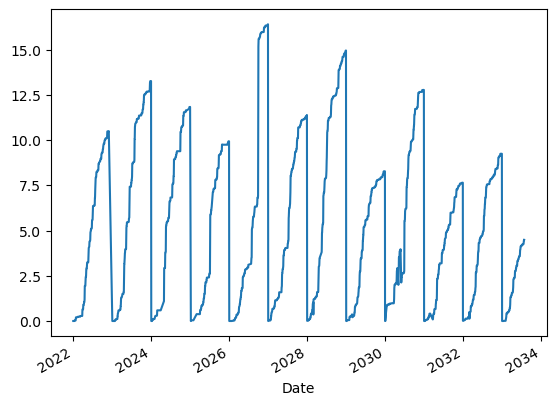

In [55]:
WeatherData["Rainfall_for_year_in"].plot()

In [56]:
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller

In [90]:
WeatherData = WeatherData.sort_index()


In [92]:
WeatherData = WeatherData.resample('D').mean()


In [93]:
WeatherData.index.year.value_counts().sort_index()

2022    365
2023    365
2024    366
2025    365
2026    365
2027    365
2028    366
2029    365
2030    365
2031    365
2032    366
2033    209
Name: Date, dtype: int64

In [60]:
WeatherData.isnull().sum()

Temperature              330
Avg_humidity_PC          330
Avg_dewpoint             330
Avg_barometer_in         330
Avg_windspeed_mph        330
Avg_gustspeed_mph        330
Avg_direction            330
Rainfall_for_month_in    330
Rainfall_for_year_in     330
Max_temp                 330
Min_temp                 330
Max_humidity_Pc          330
Min_humidity_Pc          330
Max_pressure             330
Min_pressure             330
Max_windspeed_mph        330
Max_gustspeed_mph        330
Max_heat_index           330
diff_pressure            330
dtype: int64

In [61]:
# Loop over all columns in the DataFrame
for col in WeatherData.columns:
    # Interpolate the missing values using linear interpolation
    WeatherData[col] = WeatherData[col].interpolate(method='linear')

In [62]:
#import pandas as pd
#from statsmodels.tsa.statespace.sarimax import SARIMAX

# Assume that your data is stored in a pandas DataFrame called `WeatherData`
# with columns labeled 0 through 20
# and that the dates are stored in a column called 'date'



# Define the SARIMAX model
#model = SARIMAX(WeatherData['Temperature'], order=(1, 1, 1), seasonal_order=(1, 1, 1, 12))

#model = SARIMAX(WeatherData['Temperature'], order=(1, 0, 0), seasonal_order=(0, 0, 0, 0))


# Fit the model to the data
#results = model.fit()

# Generate predictions for the next two years
#start = pd.to_datetime('2022-01-01')
#end = pd.to_datetime('2033-07-28')
#start = pd.to_datetime('2034-01-01')
#end = pd.to_datetime('2035-12-30')

#pred = results.get_prediction(start=start, end=end, dynamic=False)

# Print the predicted values
#print(pred.predicted_mean)

# Save the predicted values to a CSV file
#pred_df = pd.DataFrame(pred.predicted_mean)
#pred_df.to_csv('predicted_values.csv')



In [63]:
print(WeatherData.columns)


Index(['Temperature', 'Avg_humidity_PC', 'Avg_dewpoint', 'Avg_barometer_in',
       'Avg_windspeed_mph', 'Avg_gustspeed_mph', 'Avg_direction',
       'Rainfall_for_month_in', 'Rainfall_for_year_in', 'Max_temp', 'Min_temp',
       'Max_humidity_Pc', 'Min_humidity_Pc', 'Max_pressure', 'Min_pressure',
       'Max_windspeed_mph', 'Max_gustspeed_mph', 'Max_heat_index',
       'diff_pressure'],
      dtype='object')


In [64]:
# Check for duplicate values
print(WeatherData.duplicated().sum())



0


In [65]:
# Drop duplicates
WeatherData.drop_duplicates(inplace=True)


In [66]:
# Check data types
print(WeatherData.info())



<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4227 entries, 2022-01-01 to 2033-07-28
Freq: D
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Temperature            4227 non-null   float64
 1   Avg_humidity_PC        4227 non-null   float64
 2   Avg_dewpoint           4227 non-null   float64
 3   Avg_barometer_in       4227 non-null   float64
 4   Avg_windspeed_mph      4227 non-null   float64
 5   Avg_gustspeed_mph      4227 non-null   float64
 6   Avg_direction          4227 non-null   float64
 7   Rainfall_for_month_in  4227 non-null   float64
 8   Rainfall_for_year_in   4227 non-null   float64
 9   Max_temp               4227 non-null   float64
 10  Min_temp               4227 non-null   float64
 11  Max_humidity_Pc        4227 non-null   float64
 12  Min_humidity_Pc        4227 non-null   float64
 13  Max_pressure           4227 non-null   float64
 14  Min_pressure           4227 no

In [67]:
#!sudo chown username:username merged_data.csv


In [68]:
#import pandas as pd

# assume your temperature data is stored in a pandas DataFrame called `weather_data`
# with a column named 'Temperature' and a date index

# define the window size for the moving average
#window_size = 7

# calculate the rolling mean using the window size
#rolling_mean = WeatherData['Temperature'].rolling(window=window_size).mean()

# plot the original data and the rolling mean
#ax = WeatherData.plot(y='Temperature', label='Original Data')
#rolling_mean.plot(ax=ax, label='Rolling Mean')

# Save the smoothed data to a new file
#weather_data.to_csv('smoothed_weather_data.csv', index=False)

In [69]:
#import pandas as pd
#from scipy.signal import savgol_filter

# Define a function to smooth a column using a Savitzky-Golay filter
#def smooth_column(data, column, window_size=11, polyorder=2):
 #   smoothed = savgol_filter(data[column], window_size, polyorder)
  #  data[column] = smoothed
   # return data

# Loop over all the columns in the data and apply the smoothing function
#for column in WeatherData.columns:
 #   WeatherData = smooth_column(WeatherData, column)
# Save the smoothed data to a new file
#WeatherData.to_csv('smoothed_weather_data.csv', index=False)

In [70]:
#import pandas as pd

# Load the CSV file
#smooth_weatherdata = pd.read_csv("C:/Users/sumit/Downloads/iNeuron_FSDA-main/EDA Project/Hicounciler Wheather&Forcast/smoothed_weather_data.csv")

# Print the first 5 rows of the data frame
#smooth_weatherdata.head()


In [71]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Create a new DataFrame to store the predictions
pred_df = pd.DataFrame(index=pd.date_range(start='2033-07-29', end='2035-12-31'))

# Loop over each column in the DataFrame and fit a SARIMAX model
for col in WeatherData.columns:
    if col == 'Month':
        continue  # Skip this column
    
    print(f"Fitting SARIMAX model for {col}...")
    
    # Split the data into training and testing sets
    train = WeatherData[col]['2022-01-01':'2033-7-28']
    test = WeatherData[col]['2033-07-29':]

    # Fit a SARIMAX model to the training data
    model = SARIMAX(train, order=(1, 0, 1), seasonal_order=(1, 0, 1, 12))
    results = model.fit(maxiter=10000)

    # Generate predictions for the test data
    predictions = results.predict(start='2033-07-29', end='2035-12-31')

    # Add the predictions to the pred_df DataFrame
    pred_df[col] = predictions

# Save the predicted values to a new CSV file
pred_df.to_csv('predictions.csv')


Fitting SARIMAX model for Temperature...
Fitting SARIMAX model for Avg_humidity_PC...
Fitting SARIMAX model for Avg_dewpoint...
Fitting SARIMAX model for Avg_barometer_in...


C:\Users\sumit\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Fitting SARIMAX model for Avg_windspeed_mph...
Fitting SARIMAX model for Avg_gustspeed_mph...
Fitting SARIMAX model for Avg_direction...
Fitting SARIMAX model for Rainfall_for_month_in...
Fitting SARIMAX model for Rainfall_for_year_in...
Fitting SARIMAX model for Max_temp...
Fitting SARIMAX model for Min_temp...
Fitting SARIMAX model for Max_humidity_Pc...
Fitting SARIMAX model for Min_humidity_Pc...
Fitting SARIMAX model for Max_pressure...
Fitting SARIMAX model for Min_pressure...
Fitting SARIMAX model for Max_windspeed_mph...
Fitting SARIMAX model for Max_gustspeed_mph...
Fitting SARIMAX model for Max_heat_index...
Fitting SARIMAX model for diff_pressure...


In [72]:
WeatherData.to_csv('WeatherClean.csv')

In [73]:
WeatherClean=pd.read_csv("C://Users/sumit/Downloads/iNeuron_FSDA-main/EDA Project/Hicounciler Wheather&Forcast/WeatherClean.csv")
WeatherClean.head()

,Date,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
0,2022-01-01,35.1,30.5,5.80,30.10,18.60,26.05,254.0,0.0,0.0,42.10,28.35,30.0,18.5,30.2020,29.9590,35.10,53.10,42.10,0.2430
1,2022-01-02,39.9,35.0,12.05,30.00,10.25,14.35,236.5,0.0,0.0,52.40,24.70,41.0,16.5,30.2575,29.6960,27.65,41.05,52.40,0.5615
2,2022-01-03,34.7,40.5,9.40,29.90,9.45,13.85,263.5,0.0,0.0,46.65,21.00,18.0,25.0,30.2630,29.5825,27.05,43.75,46.65,0.6805
3,2022-01-04,27.2,42.5,1.80,30.30,6.70,9.70,142.5,0.0,0.0,37.05,18.95,20.5,22.5,30.4355,30.1935,16.15,24.95,43.55,0.2420
4,2022-01-05,33.5,29.5,3.15,29.95,11.95,16.55,254.0,0.0,0.0,43.30,21.55,30.0,14.5,30.2555,29.7010,29.35,42.05,44.30,0.5545


In [74]:
# Convert the date column to a pandas datetime object
WeatherClean['Date']=pd.to_datetime(WeatherClean['Date'])

In [75]:
# Set the date column as the index of your DataFrame
WeatherClean.set_index('Date', inplace=True)

In [76]:
WeatherClean.head()

,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
Date,,,,,,,,,,,,,,,,,,,
2022-01-01,35.1,30.5,5.80,30.10,18.60,26.05,254.0,0.0,0.0,42.10,28.35,30.0,18.5,30.2020,29.9590,35.10,53.10,42.10,0.2430
2022-01-02,39.9,35.0,12.05,30.00,10.25,14.35,236.5,0.0,0.0,52.40,24.70,41.0,16.5,30.2575,29.6960,27.65,41.05,52.40,0.5615
2022-01-03,34.7,40.5,9.40,29.90,9.45,13.85,263.5,0.0,0.0,46.65,21.00,18.0,25.0,30.2630,29.5825,27.05,43.75,46.65,0.6805
2022-01-04,27.2,42.5,1.80,30.30,6.70,9.70,142.5,0.0,0.0,37.05,18.95,20.5,22.5,30.4355,30.1935,16.15,24.95,43.55,0.2420
2022-01-05,33.5,29.5,3.15,29.95,11.95,16.55,254.0,0.0,0.0,43.30,21.55,30.0,14.5,30.2555,29.7010,29.35,42.05,44.30,0.5545


In [79]:
predicted_Data=pd.read_csv("C://Users/sumit/Downloads/iNeuron_FSDA-main/EDA Project/Hicounciler Wheather&Forcast/predictions.csv")

predicted_Data.head()

,Date,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
0,29/07/2033,58.175493,56.545905,43.751021,29.736623,3.775702,6.055659,203.615408,0.333377,4.467875,73.833382,42.418280,90.639917,30.372147,29.847888,29.671524,16.924512,23.408324,75.837275,0.123005
1,30/07/2033,56.106973,53.241060,42.094843,29.713769,4.305687,6.642718,205.078246,0.317204,4.456977,72.094127,40.856236,88.509868,29.508952,29.808065,29.674622,17.202638,23.162766,73.832530,0.112750
2,31/07/2033,54.470998,50.775907,40.405905,29.696331,4.390803,6.681464,199.327241,0.307098,4.433498,71.449612,38.544255,85.948164,27.046574,29.794070,29.684793,16.795426,23.028857,73.316362,0.111588
3,01/08/2033,54.917826,46.752441,39.238749,29.667620,5.045407,7.422243,201.447312,0.292260,4.418141,71.536891,39.111684,80.490882,24.846246,29.762667,29.676596,18.406745,25.098299,73.282600,0.107769
4,02/08/2033,53.101122,48.975939,38.956033,29.689152,4.790566,7.112189,203.743646,0.278465,4.398395,69.652653,37.781647,81.474143,25.189126,29.797729,29.673359,17.351670,23.790141,71.405430,0.103022


In [80]:
# Convert the date column to a pandas datetime object
predicted_Data['Date']=pd.to_datetime(predicted_Data['Date'])

C:\Users\sumit\AppData\Local\Temp\ipykernel_15752\1642750226.py:2: UserWarning: Parsing '29/07/2033' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  predicted_Data['Date']=pd.to_datetime(predicted_Data['Date'])
C:\Users\sumit\AppData\Local\Temp\ipykernel_15752\1642750226.py:2: UserWarning: Parsing '30/07/2033' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  predicted_Data['Date']=pd.to_datetime(predicted_Data['Date'])
C:\Users\sumit\AppData\Local\Temp\ipykernel_15752\1642750226.py:2: UserWarning: Parsing '31/07/2033' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  predicted_Data['Date']=pd.to_datetime(predicted_Data['Date'])
C:\Users\sumit\AppData\Local\Temp\ipykernel_15752\1642750226.py:2: UserWarning: Parsing '13/08/2033' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  predic

In [81]:
# Set the date column as the index of your DataFrame
predicted_Data.set_index('Date', inplace=True)

In [82]:
predicted_Data.head()

,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
Date,,,,,,,,,,,,,,,,,,,
2033-07-29,58.175493,56.545905,43.751021,29.736623,3.775702,6.055659,203.615408,0.333377,4.467875,73.833382,42.418280,90.639917,30.372147,29.847888,29.671524,16.924512,23.408324,75.837275,0.123005
2033-07-30,56.106973,53.241060,42.094843,29.713769,4.305687,6.642718,205.078246,0.317204,4.456977,72.094127,40.856236,88.509868,29.508952,29.808065,29.674622,17.202638,23.162766,73.832530,0.112750
2033-07-31,54.470998,50.775907,40.405905,29.696331,4.390803,6.681464,199.327241,0.307098,4.433498,71.449612,38.544255,85.948164,27.046574,29.794070,29.684793,16.795426,23.028857,73.316362,0.111588
2033-01-08,54.917826,46.752441,39.238749,29.667620,5.045407,7.422243,201.447312,0.292260,4.418141,71.536891,39.111684,80.490882,24.846246,29.762667,29.676596,18.406745,25.098299,73.282600,0.107769
2033-02-08,53.101122,48.975939,38.956033,29.689152,4.790566,7.112189,203.743646,0.278465,4.398395,69.652653,37.781647,81.474143,25.189126,29.797729,29.673359,17.351670,23.790141,71.405430,0.103022


In [83]:
predicted_Data.tail()

,Temperature,Avg_humidity_PC,Avg_dewpoint,Avg_barometer_in,Avg_windspeed_mph,Avg_gustspeed_mph,Avg_direction,Rainfall_for_month_in,Rainfall_for_year_in,Max_temp,Min_temp,Max_humidity_Pc,Min_humidity_Pc,Max_pressure,Min_pressure,Max_windspeed_mph,Max_gustspeed_mph,Max_heat_index,diff_pressure
Date,,,,,,,,,,,,,,,,,,,
2035-12-27,42.598552,47.547630,21.240686,29.009669,5.523127,7.791487,92.496668,-6.950000e-13,-0.152594,55.862909,28.954712,72.984981,25.197874,28.834309,29.315166,19.071127,23.974542,55.186691,6.560000e-13
2035-12-28,42.775388,47.183276,21.263864,28.922803,5.536568,7.857935,92.477740,-7.050000e-13,-0.153839,55.393353,30.023290,73.211229,24.551679,28.783500,29.322573,18.791601,23.993179,54.549990,6.370000e-13
2035-12-29,42.437139,47.902862,21.168342,28.941067,5.649294,7.917797,92.104229,-6.760000e-13,-0.148769,54.857284,29.886449,74.063296,24.736374,28.783200,29.329240,18.551436,23.458990,54.321828,6.190000e-13
2035-12-30,42.269864,50.688853,21.594258,28.993184,4.950544,7.107388,92.846841,-6.240000e-13,-0.146946,54.797019,30.102132,73.356187,27.355132,28.821711,29.329109,17.653776,21.855197,54.237092,6.010000e-13
2035-12-31,42.523471,49.646767,21.460888,29.024132,5.231782,7.396876,92.127903,-6.170000e-13,-0.149070,55.410563,29.545033,74.605612,26.294758,28.885441,29.324988,17.987583,22.541042,54.901834,5.830000e-13


In [ ]:
# Merge Both Train and Test dataset
WeatherDataNew=WeatherClean.append(predicted_Data)
WeatherDataNew.head(100)

In [ ]:
WeatherDataNew.to_csv('WeatherDataNew.csv')

In [ ]:
#from fbprophet import Prophet

# Convert the WeatherData DataFrame to the format required by Prophet
#data = WeatherData.rename(columns={'Date': 'ds', 'Temperature': 'y'})

# Create a new Prophet model
#model = Prophet()

# Fit the model to the data
#model.fit(data)

# Create a new DataFrame to store the predictions
#future = model.make_future_dataframe(periods=365)

# Generate predictions for the future dates
#predictions = model.predict(future)

# Save the predicted values to a new CSV file
#predictions[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].to_csv('predictions3.csv', index=False)


In [ ]:
#pip install pystan

In [ ]:
#iopub_data_rate_limit=100000000

In [ ]:
#pip install fbprophet

In [5]:
#pip install tensorflow


     -------------------------------------- 266.3/266.3 MB 1.7 MB/s eta 0:00:00
     ---------------------------------------- 6.0/6.0 MB 3.8 MB/s eta 0:00:00
     ---------------------------------------- 3.7/3.7 MB 4.0 MB/s eta 0:00:00
     ---------------------------------------- 23.2/23.2 MB 3.3 MB/s eta 0:00:00
     ---------------------------------------- 1.7/1.7 MB 3.6 MB/s eta 0:00:00
     ---------------------------------------- 1.5/1.5 MB 4.1 MB/s eta 0:00:00
     ------------------------------------- 439.2/439.2 kB 26.8 MB/s eta 0:00:00
     -------------------------------------- 57.5/57.5 kB 597.9 kB/s eta 0:00:00
     ---------------------------------------- 65.5/65.5 kB 3.5 MB/s eta 0:00:00
     -------------------------------------- 126.5/126.5 kB 3.8 MB/s eta 0:00:00
     -------------------------------------- 895.9/895.9 kB 5.1 MB/s eta 0:00:00
     -------------------------------------- 781.3/781.3 kB 6.2 MB/s eta 0:00:00
     -------------------------------------- 177.

In [95]:
#import numpy as np
#import pandas as pd
#from sklearn.preprocessing import MinMaxScaler
#from tensorflow.keras.models import Sequential
#from tensorflow.keras.layers import Dense, LSTM

# Load the data # Using LSTM (Long Short-Term Memory) Model
#WeatherData = pd.read_csv('weather_data.csv', index_col=0, parse_dates=True)

# Set the number of time steps to use for predictions
#n_steps = 12

# Split the data into training and testing sets
#train = WeatherData.iloc[:-24]
#test = WeatherData.iloc[-24:]

# Scale the data
#scaler = MinMaxScaler()
#train_scaled = scaler.fit_transform(train)
#test_scaled = scaler.transform(test)

# Create sequences for the training data
#train_seq = []
#train_labels = []
#for i in range(n_steps, len(train_scaled)):
#    train_seq.append(train_scaled[i-n_steps:i])
#    train_labels.append(train_scaled[i])

#train_seq = np.array(train_seq)
#train_labels = np.array(train_labels)

# Build the LSTM model
#model = Sequential()
#model.add(LSTM(64, activation='relu', input_shape=(n_steps, train_seq.shape[2])))
#model.add(Dense(1))

# Compile the model
#model.compile(optimizer='adam', loss='mse')

# Train the model
#model.fit(train_seq, train_labels, epochs=100, batch_size=32)

# Create sequences for the test data
#test_seq = []
#for i in range(n_steps, len(test_scaled)):
#    test_seq.append(test_scaled[i-n_steps:i])

#test_seq = np.array(test_seq)

# Generate predictions for the test data
#predictions = model.predict(test_seq)

# Invert the scaling
#predictions = scaler.inverse_transform(predictions)
#test = scaler.inverse_transform(test_scaled)

# Create a DataFrame to store the predictions
#pred_df = pd.DataFrame(predictions, index=test.index, columns=test.columns)

# Save the predicted values to a new CSV file
#pred_df.to_csv('predictions4.csv')


Epoch 1/100
131/131 [==============================] - 2s 6ms/step - loss: 0.0958
Epoch 2/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0943
Epoch 3/100
131/131 [==============================] - 1s 7ms/step - loss: 0.0942
Epoch 4/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0942
Epoch 5/100
131/131 [==============================] - 1s 7ms/step - loss: 0.0942
Epoch 6/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0942
Epoch 7/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0942
Epoch 8/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0942
Epoch 9/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0942
Epoch 10/100
131/131 [==============================] - 1s 7ms/step - loss: 0.0941
Epoch 11/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0941
Epoch 12/100
131/131 [==============================] - 1s 6ms/step - loss: 0.0941
Epoch 13/100


ValueError: non-broadcastable output operand with shape (12,1) doesn't match the broadcast shape (12,19)